# Setup notebook

In [1]:
%reload_ext autoreload
%autoreload 2

In [32]:
import pandas as pd
import polars as pl
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os
from pathlib import Path
from typing import Optional, Tuple, List, Dict
from numpy.typing import NDArray
from scipy import stats

import sys
sys.path.append("../src/main/python")

from peak_analysis.helper_methods import (
    process_data,
    calculate_peak_aggregates,
    format_peak_data,
    format_agg_data,
    two_sample_t_test,
    plot_processing,
    plot_agg_output_comparison,
    plot_output_distribution
)
from peak_analysis import (
    BaseLineFitter,
    ZeroBaselineFitter,
    FirstNBaseLineFitter,
    ModPolyBaseLineFitter,
    ModPolyCustomBaseLineFitter,
    IModPolyBaseLineFitter,
    PeakDetector,
    ScipyPeakDetector,
    NoiseSDScipyPeakDetector,
    RobustNoiseSDScipyPeakDetector,
    SingleMaxPeakDetector,
    TraceProcessor,
)

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
warnings.filterwarnings("ignore", message="FigureCanvasAgg is non-interactive, and thus cannot be shown")

In [3]:

fp = mpl.font_manager.FontProperties(fname=r"C:\Users\tamas\AppData\Local\Microsoft\Windows\Fonts\Helvetica.ttf")
# fp = mpl.font_manager.FontProperties(fname=r"C:\Windows\Fonts\Arial.ttf")
print(fp.get_name())
# when installing a new non-system font the cache needs to be deleted
print(mpl.get_cachedir())

Helvetica
C:\Users\tamas\.matplotlib


In [4]:
params = {
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'font.family': 'Helvetica',
    'axes.labelsize': 'large',
    'axes.titlesize':'large',
    'xtick.labelsize':'large',
    'ytick.labelsize':'large',
    'axes.linewidth': 2,
    'figure.dpi': 150
}
mpl.rcParams.update(params)

# Read in data

In [5]:
KEEP_PEAKLESS = True
UPSIDE_DOWN = True

root_path: Path = Path("C:/python_projects/peak_analysis/peak_analysis")
DATA_PATH: Path = root_path / "data/covid_vaccine/CaMobilization/R-CEPIA1er/"
OUTPUT_PATH: Path = root_path / "notebooks/output/covid_vaccine/CaMobilization/R-CEPIA1er/"
OUTPUT_PATH.mkdir(parents=True, exist_ok=True)
    
if not KEEP_PEAKLESS:
    OUTPUT_PATH = OUTPUT_PATH / "resp_only"

## Read in raw files

### Polars refactor

In [ ]:
# fname_list: List[str] = os.listdir(DATA_PATH)
# _combined_data_list: List[pd.DataFrame] = []
# for fname in fname_list:
#     if not fname.endswith(".xlsx"):
#         continue
#     print(f"Reading file: {fname}")
#     all_sheets: Dict[str, pd.DataFrame] = pd.read_excel(
#         DATA_PATH + "/" + fname,
#         sheet_name=None,
#         converters={'date': str}
#     )
#     sheet_names: List[str] = all_sheets.keys()
#     # every file should only haved 1 sheey with data
#     assert len(sheet_names) == 2
#     data_sheet_name: str = [x for x in sheet_names if x != "metadata"][0]
#     if "metadata" not in all_sheets:
#         raise ValueError(f"File {fname} has no metadata sheet!")
#     metadata: pd.DataFrame = all_sheets["metadata"]
#     if metadata.loc[0, "temp"] == "RT":
#         metadata.loc[0, "temp"] = 24
#     # strip leading or ending spaces from metadata columns
#     metadata = metadata.rename(columns=lambda x: x.strip())
#     # make sure filename matches date and experiment number
#     date_in_metadata: str = str(metadata.loc[0, "date"])
#     date_in_fname = fname.split("_")[0]
#     if date_in_metadata != date_in_fname:
#         raise ValueError(f"Filename {fname} starts with {date_in_fname} but metadata has date: {date_in_metadata}!")
#     expno_in_metadata: int = int(metadata.loc[0, "exp_no"])
#     expno_in_fname = int(fname.split("_")[1].split(".")[0])
#     if expno_in_metadata != expno_in_fname:
#         raise ValueError(f"Filename {fname} ends with {expno_in_fname} but metadata has exp_no: {expno_in_metadata}!")
#     # some files might not have the concentration filled in
#     if "concentration" not in metadata.columns:
#         print("Adding empty metadata column!")
#         metadata.loc[0, "concentration"] = np.nan
    
#     # raw data looks like this
#     #      Unnamed: 0          1           2           3           4           5  \
#     # 0      0.002567  62.015256   46.568287   46.142516   92.456157   70.760620   
#     # 1      0.035900  62.015256   46.568287   45.971681   93.022291   70.886220   
#     # 2      0.069233  62.015256   46.568287   45.914747   92.966617   71.284953   
#     # 3      0.102570  62.015256   46.610153   45.781920   93.048856   72.203746   
#     # 4      0.135900  61.970388   46.678719   46.295620   92.754034   72.468567   
#     # ..          ...        ...         ...         ...         ...         ...   
#     # 865   28.835900  90.698753  109.649437  114.223892  113.125968  109.303379   
#     # 866   28.869230  91.150643  108.574125  114.751294  111.517170  108.384195   
#     # 867   28.902570  91.195662  108.893083  115.628398  110.388241  108.103196   
#     # 868   28.935900  91.697802  108.893083  114.077102  110.141647  107.887586   
#     # 869   28.969230  91.665613  108.893083  112.476766  109.831955  107.601778
#     data: pl.DataFrame = (
#         pl.from_pandas(all_sheets[data_sheet_name])
#         .rename({"Unnamed: 0": "time(m)"})
#         .with_row_index("pos")
#     )
#     if data['time(m)'].is_null().any():
#         raise ValueError("Missing time index!")
#     # time index is unreliable -> create a new one starting at 0, sampled every 2 seconds
#     sampling_rate: float = 2/60
#     data: pl.DataFrame = data.with_columns((pl.col("pos") * sampling_rate).alias("time(m)"))
#     # handle missing values here
#     cols_missing: List[str] = [col.name for col in data if col.null_count() > 0]
#     assert 'time(m)' not in cols_missing and "pos" not in cols_missing
#     if len(cols_missing) > 0:
#         print("Missing data found, filling in with linear interpolation.")
#         data = data.with_columns(*[pl.col(col).interpolate("linear") for col in cols_missing])
#         # check again
#         cols_missing: List[str] = [col.name for col in data.select(cols_missing) if col.null_count() > 0]
#         if len(cols_missing) > 0:
#             # data can't be interpolated -> no non-missing endpoint -> dropping missing rows
#             print("Missing data couldnt be interpolated, dropping missing rows!")
#             data = data.drop_nans(subset=cols_missing)
            
#     # convert to long format
#     data = data.unpivot(index=['time(m)', 'pos'], variable_name="cell_nr")
#     # add metadata
#     data = data.with_columns(*[pl.lit(metadata.loc[0, c]).alias(c) for c in metadata.columns])
#     _combined_data_list.append(data)
#     print("-----------------------------")
# print("File reading finished, creating combined DataFrame.")
# pl_combined_data: pl.DataFrame = pl.concat(_combined_data_list, how="vertical")
# del _combined_data_list
# missing_values = pl_combined_data.filter(pl.col("value").is_null())
# if len(missing_values) > 0:
#     raise ValueError(
#         f"Data missing at times: {missing_values['time(m)'].unique().to_list()}"
#     )
# # make sure the positional index is a bijector of the time
# # First test whether every timestamp has a unique position value
# pl_test: pl.DataFrame = (
#     pl_combined_data
#     .group_by(["time(m)"])
#     .agg(pl.col("pos").n_unique())
# )


# if not pl_test["pos"].min() == pl_test["pos"].max() == 1:
#     error_msg = "Ambigous time index values found!\n"
#     ambigous_time_values: List[float] = pl_test.filter(pl.col("pos") > 1)["time(m)"].to_list()
#     # get the time indices with multiple position values, and the unique pos values they have
#     # time(m)
#     # 0.1          [3, 1]
#     # 0.2          [6, 2]
#     #            ...     
#     pl_ambigous: pl.DataFrame = (
#         pl_combined_data
#         .filter(pl.col("time(m)").is_in(ambigous_time_values))
#         .select("time(m)", "pos")
#         .unique()
#         .group_by("time(m)")
#         .agg(pl.col("pos"))
#     )
#     error_msg += f"Ambigous time index values and their unique pos values:\n{pl_ambigous}"
#     # find 1 example file for each pos value for the first ambigous time index
#     error_msg += "\nSet of example files for first ambigous time index value:"
#     # for pos in df_ambigous.iloc[0]:
#     #     # date and experiment number for example
#     #     _example: list = (
#     #         df_combined_data.loc[
#     #             (df_combined_data["time(m)"] == df_ambigous.index[0])
#     #             & (df_combined_data["pos"] == pos),
#     #             ["date", "exp_no"]
#     #         ]
#     #         .iloc[0]
#     #         .tolist()
#     #     )
#     #     error_msg +=f"\n{_example[0]}_{_example[1]}.xlsx"
#     raise ValueError(error_msg)
# # # Now do the reverse, check if every pos has a unique timestamp
# # df_test: pd.DataFrame = (
# #     df_combined_data
# #     .groupby(["pos"])
# #     .agg({"time(m)": 'nunique'})
# # )
# # if not (df_test.describe().loc[["min", "max"], "time(m)"] == 1.0).all():
# #     error_msg = "Ambigous timestamp values found!\n"
# #     ambigous_pos_values: List[float] = df_test[df_test["time(m)"] > 1].index.to_list()
# #     df_ambigous: pd.DataFrame = (
# #         df_combined_data
# #         .loc[df_combined_data["pos"].isin(ambigous_pos_values)]
# #         .groupby("pos")["time(m)"]
# #         .unique()
# #     )
# #     error_msg += f"Ambigous pos values and their unique timestamp values:\n{df_ambigous}"
# #     # find 1 example file for each pos value for the first ambigous time index
# #     error_msg += "\nSet of example files for first ambigous pos value:"
# #     for pos in df_ambigous.iloc[0]:
# #         # date and experiment number for example
# #         _example: list = (
# #             df_combined_data.loc[
# #                 (df_combined_data["pos"] == df_ambigous.index[0])
# #                 & (df_combined_data["time(m)"] == pos),
# #                 ["date", "exp_no"]
# #             ]
# #             .iloc[0]
# #             .tolist()
# #         )
# #         error_msg +=f"\n{_example[0]}_{_example[1]}.xlsx"
# #     raise ValueError(error_msg)
# # # create a unique ID for every cell
# # # get rid of underscore in dilution
# # df_combined_data["dilution"] = df_combined_data["dilution"].astype(str).str.replace("_", "in")
# # # convert concentration to scientific notation string
# # # df_combined_data.rename({"concentration": "conc_num"}, axis=1, inplace=True)
# # df_combined_data["concentration"] = df_combined_data["concentration"].apply(lambda x: "{:.1E}".format(x))
# # # df_combined_data.drop(["conc_num"], axis=1, inplace=True)
# # # create unique ID for all cells
# # id_cols = metadata.columns.to_list() + ["cell_nr"]
# # print("Creating ID column.")
# # df_combined_data["cell_ID"] = (
# #     df_combined_data[id_cols]
# #     .apply(lambda x: '-'.join(x.astype(str).values), axis=1)
# # )
# # print(id_cols)


Reading file: 20240802_02.xlsx
-----------------------------
Reading file: 20240802_03.xlsx
-----------------------------
Reading file: 20240802_04.xlsx
-----------------------------
Reading file: 20240802_05.xlsx
-----------------------------
Reading file: 20240802_07.xlsx
-----------------------------
Reading file: 20240802_08.xlsx
-----------------------------
Reading file: 20240802_09.xlsx
-----------------------------
Reading file: 20240802_10.xlsx
-----------------------------
Reading file: 20240813_02.xlsx
-----------------------------
Reading file: 20240813_03.xlsx
-----------------------------
Reading file: 20240813_04.xlsx
-----------------------------
Reading file: 20240813_05.xlsx
-----------------------------
Reading file: 20240813_06.xlsx
-----------------------------
Reading file: 20240813_07.xlsx
-----------------------------
Reading file: 20240813_08.xlsx
-----------------------------
Reading file: 20240816_02.xlsx
-----------------------------
Reading file: 20240816_0

### Pandas

In [24]:
fname_list: List[str] = os.listdir(DATA_PATH)
_combined_data_list: List[pd.DataFrame] = []
for fname in fname_list:
    if not fname.endswith(".xlsx"):
        continue
    print(f"Reading file: {fname}")
    all_sheets: Dict[str, pd.DataFrame] = pd.read_excel(
        DATA_PATH  / fname,
        sheet_name=None,
        converters={'date': str}
    )
    sheet_names: List[str] = all_sheets.keys()
    # every file should only haved 1 sheey with data
    assert len(sheet_names) == 2
    data_sheet_name: str = [x for x in sheet_names if x != "metadata"][0]
    if "metadata" not in all_sheets:
        raise ValueError(f"File {fname} has no metadata sheet!")
    metadata: pd.DataFrame = all_sheets["metadata"]
    if metadata.loc[0, "temp"] == "RT":
        metadata.loc[0, "temp"] = 24
    # strip leading or ending spaces from metadata columns
    metadata = metadata.rename(columns=lambda x: x.strip())
    # make sure filename matches date and experiment number
    date_in_metadata: str = str(metadata.loc[0, "date"])
    date_in_fname = fname.split("_")[0]
    if date_in_metadata != date_in_fname:
        raise ValueError(f"Filename {fname} starts with {date_in_fname} but metadata has date: {date_in_metadata}!")
    expno_in_metadata: int = int(metadata.loc[0, "exp_no"])
    expno_in_fname = int(fname.split("_")[1].split(".")[0])
    if expno_in_metadata != expno_in_fname:
        raise ValueError(f"Filename {fname} ends with {expno_in_fname} but metadata has exp_no: {expno_in_metadata}!")
    # some files might not have the concentration filled in
    if "concentration" not in metadata.columns:
        print("Adding empty metadata column!")
        metadata.loc[0, "concentration"] = np.nan
    data: pd.DataFrame = all_sheets[data_sheet_name]
    # raw data looks like this
    #      Unnamed: 0          1           2           3           4           5  \
    # 0      0.002567  62.015256   46.568287   46.142516   92.456157   70.760620   
    # 1      0.035900  62.015256   46.568287   45.971681   93.022291   70.886220   
    # 2      0.069233  62.015256   46.568287   45.914747   92.966617   71.284953   
    # 3      0.102570  62.015256   46.610153   45.781920   93.048856   72.203746   
    # 4      0.135900  61.970388   46.678719   46.295620   92.754034   72.468567   
    # ..          ...        ...         ...         ...         ...         ...   
    # 865   28.835900  90.698753  109.649437  114.223892  113.125968  109.303379   
    # 866   28.869230  91.150643  108.574125  114.751294  111.517170  108.384195   
    # 867   28.902570  91.195662  108.893083  115.628398  110.388241  108.103196   
    # 868   28.935900  91.697802  108.893083  114.077102  110.141647  107.887586   
    # 869   28.969230  91.665613  108.893083  112.476766  109.831955  107.601778

    # add absolute index
    data = data.reset_index(drop=False)
    data = data.rename({'Unnamed: 0': 'time(m)', "index": "pos"}, axis=1)
    if data['time(m)'].isna().any():
        raise ValueError("Missing time index!")
    # time index is unreliable -> create a new one starting at 0, sampled every 2 seconds
    sampling_rate: float = 2/60
    data['time(m)'] = np.arange(start=0, stop=len(data) * sampling_rate, step=sampling_rate)
    # handle missing values here
    cols_missing: List[str] = data.columns[data.isna().any(axis=0)].to_list()
    assert 'time(m)' not in cols_missing and "pos" not in cols_missing
    if len(cols_missing) > 0:
        print("Missing data found, filling in with linear interpolation.")
        data[cols_missing] = data[cols_missing].interpolate(method='linear', axis=0)
        # data can't be interpolated -> no non-missing endpoint -> dropping missing rows
        if data[cols_missing].isna().any(axis=0).any(axis=0):
            print("Missing data couldnt be interpolated, dropping missing rows!")
            data.dropna(axis=0, inplace=True)
    # convert to long format
    data = data.melt(id_vars=['time(m)', 'pos'], var_name="cell_nr")
    # add metadata
    for c in metadata.columns:
        data[c] = metadata.loc[0, c]
    _combined_data_list.append(data)
    print("-----------------------------")
print("File reading finished, creating combined DataFrame.")
df_combined_data: pd.DataFrame = pd.concat(_combined_data_list, axis=0, ignore_index=True)
missing_filter = df_combined_data["value"].isna()
if missing_filter.any():
    raise ValueError(
        f"Data missing at times: {df_combined_data[missing_filter]['time(m)'].unique()}"
    )
# make sure the positional index is a bijector of the time
# First test whether every timestamp has a unique position value
df_test: pd.DataFrame = (
    df_combined_data
    .groupby(["time(m)"])
    .agg({"pos": 'nunique'})
)
if not (df_test.describe().loc[["min", "max"], "pos"] == 1.0).all():
    error_msg = "Ambigous time index values found!\n"
    ambigous_time_values: List[float] = df_test[df_test["pos"] > 1].index.to_list()
    # get the time indices with multiple position values, and the unique pos values they have
    # time(m)
    # 0.1          [3, 1]
    # 0.2          [6, 2]
    #            ...     
    df_ambigous: pd.DataFrame = (
        df_combined_data
        .loc[df_combined_data["time(m)"].isin(ambigous_time_values)]
        .groupby("time(m)")["pos"]
        .unique()
    )
    error_msg += f"Ambigous time index values and their unique pos values:\n{df_ambigous}"
    # find 1 example file for each pos value for the first ambigous time index
    error_msg += "\nSet of example files for first ambigous time index value:"
    for pos in df_ambigous.iloc[0]:
        # date and experiment number for example
        _example: list = (
            df_combined_data.loc[
                (df_combined_data["time(m)"] == df_ambigous.index[0])
                & (df_combined_data["pos"] == pos),
                ["date", "exp_no"]
            ]
            .iloc[0]
            .tolist()
        )
        error_msg +=f"\n{_example[0]}_{_example[1]}.xlsx"
    raise ValueError(error_msg)
# Now do the reverse, check if every pos has a unique timestamp
df_test: pd.DataFrame = (
    df_combined_data
    .groupby(["pos"])
    .agg({"time(m)": 'nunique'})
)
if not (df_test.describe().loc[["min", "max"], "time(m)"] == 1.0).all():
    error_msg = "Ambigous timestamp values found!\n"
    ambigous_pos_values: List[float] = df_test[df_test["time(m)"] > 1].index.to_list()
    df_ambigous: pd.DataFrame = (
        df_combined_data
        .loc[df_combined_data["pos"].isin(ambigous_pos_values)]
        .groupby("pos")["time(m)"]
        .unique()
    )
    error_msg += f"Ambigous pos values and their unique timestamp values:\n{df_ambigous}"
    # find 1 example file for each pos value for the first ambigous time index
    error_msg += "\nSet of example files for first ambigous pos value:"
    for pos in df_ambigous.iloc[0]:
        # date and experiment number for example
        _example: list = (
            df_combined_data.loc[
                (df_combined_data["pos"] == df_ambigous.index[0])
                & (df_combined_data["time(m)"] == pos),
                ["date", "exp_no"]
            ]
            .iloc[0]
            .tolist()
        )
        error_msg +=f"\n{_example[0]}_{_example[1]}.xlsx"
    raise ValueError(error_msg)
# create a unique ID for every cell
# get rid of underscore in dilution
df_combined_data["dilution"] = df_combined_data["dilution"].astype(str).str.replace("_", "in")
# convert concentration to scientific notation string
df_combined_data["concentration"] = df_combined_data["concentration"].apply(lambda x: "{:.1E}".format(x))
# # create unique ID for all cells
# id_cols = metadata.columns.to_list() + ["cell_nr"]
# print("Creating ID column.")
# df_combined_data["cell_ID"] = (
#     df_combined_data[id_cols]
#     .apply(lambda x: '-'.join(x.astype(str).values), axis=1)
# )
# print(id_cols)


Reading file: 20251120_1_CHO_WT.xlsx
-----------------------------
Reading file: 20251120_2_CHO_mA1.xlsx
-----------------------------
File reading finished, creating combined DataFrame.


In [25]:
# df_combined_data.to_csv(f"{DATA_PATH}combined_data.csv", index=False)
df_combined_data.to_parquet(DATA_PATH / "combined_data.parquet", index=False)

## Read in parquet file

In [21]:
pl_combined_data = (
    pl.scan_parquet(DATA_PATH / "combined_data.parquet")
    .filter(
        # pl.col("cell_type").is_in(["CHO_WT"])
        pl.col("date").is_in(["20251120"])
        # & (pl.col("exp_no") == 5)
        # & ~pl.col("application").is_in(["Krebs", "lipo e10+RR", "lipo e10+HC", "lipo e11+RR", "lipo e11+HC", "lipo e11 0Ca"])
        # & pl.col("application").is_in(["lipo e11+A96"])
        # & (pl.col("pH") == 6.2)
        # & ~(
        #     (pl.col("date") == "20250310")
        #     & (pl.col("exp_no").is_in([1,4,5]))
        # )
        # | (
        #     (pl.col("date") == 20240507)
        #     & (pl.col("exp_no").is_in([4]))
        # )
        & (pl.col("time(m)") >= 0.25)
        & (pl.col("time(m)") <= 12)
    )
    .collect()

)

df_combined_data = pl_combined_data.to_pandas()

# create unique ID for all cells, we do it here rather than on the entire data because this is very expensive due to
# being a long string
id_cols = ['date', 'exp_no', 'cell_type', 'application', 'pH', 'dilution', 'concentration', 'temp', 'cell_nr']
print("Creating ID column.")
df_combined_data["cell_ID"] = (
    df_combined_data[id_cols]
    .apply(lambda x: '-'.join(x.astype(str).values), axis=1)
)

Creating ID column.


In [22]:
with pl.Config(tbl_rows=100):
    _experiments = pl_combined_data.select("date", "exp_no", "application", "cell_type").unique().sort("application", "date")
    display(_experiments)
    print(len(_experiments))

date,exp_no,application,cell_type
str,i64,str,str
"""20251120""",1,"""lipo e11""","""CHO_WT"""
"""20251120""",2,"""lipo e11""","""CHO_mA1"""


2


In [ ]:
# df_combined_data = pd.read_parquet(f"{DATA_PATH}combined_data.parquet")
# df_combined_data = df_combined_data.loc[
#     (df_combined_data["cell_type"].isin(["CHO_WT"]))
#     & df_combined_data["date"].isin(["20240813", "20241004", "20250114", "20250211", "20250408"])
#     & ~(df_combined_data["application"].isin(["Lipo10+HC","Lipo10+RR", "Lipo10_0Ca", "Lipo5+RR", "Lipo5+HC", "Lipo5_0Ca"]))
#     # & (df_combined_data["application"].isin(["lipo e10"]))
#     # & (df_combined_data["pH"]==6.4)
#     # & ~(df_combined_data["application"].isin(["Lipo15"]))
#     # &
#     #     ~(
#     #         (df_combined_data["date"] == "20250317")
#     #         & (df_combined_data["exp_no"].isin([5]))
#     #     )
#     #     | (
#     #         (df_combined_data["date"] == 20240507)
#     #         & (df_combined_data["exp_no"].isin([4]))
#     #     )
#     # )
#     # & (df_combined_data["concentration"].isin(["1.0E+10"]))
#     # & (df_combined_data["exp_no"].isin([2, 7]))
#     # & (df_combined_data["exp_no"] != 4)
#     & (df_combined_data["time(m)"] <= 15)
#     # & (df_combined_data["time(m)"] >= 13.00)
# ]

In [186]:
# df_combined_data[["date", "exp_no"]].drop_duplicates().groupby("date").count()

In [80]:
# _df_experiments = df_combined_data[["date", "exp_no", "application", "cell_type"]].drop_duplicates().sort_values("date")
# display(_df_experiments)
# print(len(_df_experiments))

## Rename application based on time segments

In [24]:
# make sure these bounds do not overlap
all_segment_bounds = [
    (0, 15.00),
    (17.5, 21.49),
    (21.5, 25.49),
    (25.5, 28.5),
]
sub_appl_names = ["main", "PS", "AITC", "caps"]
for i in range(len(all_segment_bounds)):
    sub_appl_current: str = sub_appl_names[i]
    bounds_current: Tuple[float, float] = all_segment_bounds[i]
    filter_current: pd.Series = (df_combined_data["time(m)"] >= bounds_current[0]) & (
        df_combined_data["time(m)"] <= bounds_current[1]
    )
    df_combined_data.loc[filter_current, "application_sub"] = sub_appl_current
    # the washouts between the segments need to be discarded from the analysis,
    # sometimes there is stuff at the end we also don't need, we will also call this washout
    df_combined_data["application_sub"] = df_combined_data["application_sub"].fillna("washout")

df_combined_data["application"] = (
    df_combined_data["application"] + "_" + df_combined_data["application_sub"]
)

id_cols = [
    "date",
    "exp_no",
    "cell_type",
    "application",
    "pH",
    "dilution",
    "concentration",
    "temp",
    "cell_nr",
]
df_combined_data["cell_ID"] = df_combined_data[id_cols].apply(
    lambda x: "-".join(x.astype(str).values), axis=1
)

print(
    df_combined_data.groupby(
        [
            "date",
            "exp_no",
            "cell_type",
            "pH",
            "dilution",
            "concentration",
            "temp",
            "cell_nr",
        ]
    )["application"].agg("nunique").describe()
)
print(df_combined_data["application"].unique())

count    1246.0
mean        5.0
std         0.0
min         5.0
25%         5.0
50%         5.0
75%         5.0
max         5.0
Name: application, dtype: float64
['lipo e11+HC+U73122_main' 'lipo e11+HC+U73122_washout'
 'lipo e11+HC+U73122_PS' 'lipo e11+HC+U73122_AITC'
 'lipo e11+HC+U73122_caps' 'lipo e11+A96+U73122_main'
 'lipo e11+A96+U73122_washout' 'lipo e11+A96+U73122_PS'
 'lipo e11+A96+U73122_AITC' 'lipo e11+A96+U73122_caps'
 'lipo e11+RR+U73122_main' 'lipo e11+RR+U73122_washout'
 'lipo e11+RR+U73122_PS' 'lipo e11+RR+U73122_AITC'
 'lipo e11+RR+U73122_caps' 'lipo e11+U73433_main'
 'lipo e11+U73433_washout' 'lipo e11+U73433_PS' 'lipo e11+U73433_AITC'
 'lipo e11+U73433_caps' 'lipo e11+U73122_0Ca_main'
 'lipo e11+U73122_0Ca_washout' 'lipo e11+U73122_0Ca_PS'
 'lipo e11+U73122_0Ca_AITC' 'lipo e11+U73122_0Ca_caps']


# Process data

## Run processing

In [33]:
# blacklisted_traces: List[str] = [
#     "20231002-3-CHO-Mirus6-7.4-1-1.0E+10-35-102",
#     "20231002-3-CHO-Mirus6-7.4-1-1.0E+10-35-103",
#     "20231002-3-CHO-Mirus6-7.4-1-1.0E+10-35-109"
# ]

# When the peaks are local minima and not maxima we need to flip the data
if UPSIDE_DOWN:
    df_combined_data["value"] = - df_combined_data["value"]
else:
    pass

df_peaks_list: List[pd.DataFrame] = []
df_agg_list: List[pd.DataFrame] = []
# create a new text file, if it exists delete everything
open(OUTPUT_PATH / "description.txt", 'w').close()
# we will save to a file for every condition
for condition_str in df_combined_data["application"].unique():
    # washout needs to be skipped when we analyze DRGS
    if "washout" in condition_str:
        continue
    print(f"Analyzing {condition_str}.")
    df_data = df_combined_data[
        (df_combined_data["application"] == condition_str)
        # & ~df_combined_data["cell_ID"].isin(blacklisted_traces)
    ]
    # TODO: try to get rid of wide format shenanigans
    # pivot to wide format
    df_data_wide = (
        df_data[["time(m)", "cell_ID", "value"]]
        .pivot(index="time(m)", columns="cell_ID")["value"]
        .reset_index()
    )
    df_data_wide.columns.name = None
    stdev_base: Optional[pd.Series] = None
    # to be used when multiple time segments are analized per trace
    if any(substring in condition_str for substring in ["PS", "AITC", "caps"]):
        # baseline_fitter = FirstNBaseLineFitter(
        #     agg_func=np.mean,
        #     first_n=15
        # )
        # peak_detector = SingleMaxPeakDetector(
        #     min_peak_amplitude=(25.0, 25.0),
        #     earliest_peak_pos=0,
        # )
        pass
    else:
        # calculate pre-treatment standard deviation for all traces
        _df_data_start = df_data[
            # (df_data["time(m)"] >= 0) & (df_data["time(m)"] <= 0.5)
            # (df_data["time(m)"] >= 6.5) & (df_data["time(m)"] <= 7.0)
            (df_data['time(m)'] >= 1.5) & (df_data['time(m)'] <= 2)
        ].drop("time(m)", axis=1)
        stdev_base = _df_data_start.groupby("cell_ID")["value"].std()
        # true peaks cannot appear before 3 minutes!
        # NOTE: This assumes data is read in from the start. If not, position 0 will not correspond to minute 0.0!
        # earliest_peak_pos: int = df_data[df_data["time(m)"] <= 3.0]["pos"].max()
        earliest_peak_pos: int = 0
        # baseline_fitter = ModPolyCustomBaseLineFitter(
        #     poly_order=2, optional_segment_length=earliest_peak_pos
        # )
        baseline_fitter = ZeroBaselineFitter()
        peak_detector = RobustNoiseSDScipyPeakDetector(
            prominence_in_stdev=8,
            wlen=100,
            distance=20,
            min_peak_amplitude=(0.1, 0.1),
            earliest_peak_pos=earliest_peak_pos,
            lower_quantile=0.05,
            upper_quantile=0.55,
            which_stdev ="estimated",
        )
        # peak_detector = NoiseSDScipyPeakDetector(
        #     prominence_in_stdev=10,
        #     wlen=30,
        #     distance=30,
        #     min_peak_amplitude=(10.0, 10.0),
        #     earliest_peak_pos=earliest_peak_pos,
        # )

    _df_proc, df_peaks = process_data(
        df_input=df_data_wide,
        time_colname="time(m)",
        baseline_fitter=baseline_fitter,
        peak_detector=peak_detector,
        s_stdev=stdev_base,
    )
    # append to description, useful when analyzing agonists
    with open(OUTPUT_PATH / "description.txt", "a") as text_file:
        text_file.write(
            "-----------------------------------\n"
            f"Peak detection for: {condition_str}\n"
            + "-----------------------------------\n"
            + baseline_fitter.description
            + peak_detector.description + "\n"
        )

    if KEEP_PEAKLESS:
        # We will temporarily fill in zeros for cells which didnt have a peak
        _all_cells = pd.DataFrame(
            {"cell_ID": [x for x in df_data_wide.columns if x != "time(m)"]}
        )
        df_peaks = _all_cells.merge(df_peaks, how="outer", on="cell_ID").fillna(
            {"amplitude": 0}
        )
        df_agg = calculate_peak_aggregates(df_peaks)
        df_peaks = df_peaks.dropna(axis=0).reset_index(drop=True)
    else:
        df_agg = calculate_peak_aggregates(df_peaks)

    # add new peak_nr column in the first position, index it starting at 1
    df_peaks.insert(loc=0, column="peak_nr", value=df_peaks.index + 1)
    # add new cell_nr column in the first position, index it starting at 1
    df_agg.insert(loc=0, column="cell_nr_combined", value=df_agg.index + 1)
    # split the id into metadata columns for easier handling
    if len(df_agg) == 0:
        df_agg = df_agg.reindex(
            df_agg.columns.tolist()
            + [
                "date",
                "exp_no",
                "cell_type",
                "application",
                "pH",
                "dilution",
                "concentration",
                "temp",
                "cell_nr",
            ],
            axis=1,
        )
    else:
        df_agg[
            [
                "date",
                "exp_no",
                "cell_type",
                "application",
                "pH",
                "dilution",
                "concentration",
                "temp",
                "cell_nr",
            ]
        ] = df_agg["cell_ID"].str.split("-", expand=True)
    if len(df_peaks) == 0:
        df_peaks = df_peaks.reindex(
            df_peaks.columns.tolist()
            + [
                "date",
                "exp_no",
                "cell_type",
                "application",
                "pH",
                "dilution",
                "concentration",
                "temp",
                "cell_nr",
            ],
            axis=1,
        )
    else:
        df_peaks[
            [
                "date",
                "exp_no",
                "cell_type",
                "application",
                "pH",
                "dilution",
                "concentration",
                "temp",
                "cell_nr",
            ]
        ] = df_peaks["cell_ID"].str.split("-", expand=True)

    # save to file
    df_peaks_list.append(df_peaks)
    df_agg_list.append(df_agg)

pd.concat(df_peaks_list, axis=0).to_excel(
    OUTPUT_PATH / "peak_analysis.xlsx", index=False
)
pd.concat(df_agg_list, axis=0).to_excel(
    OUTPUT_PATH / "cell_analysis.xlsx", index=False
)
    # save histogram
    # fig, ax = plt.subplots()
    # sns.histplot(peak_output, x="time(m)", bins=35, ax=ax).get_figure()
    # ax.set_title(condition_str)
    # fig.savefig(f"{OUTPUT_PATH}/time_histogram_{condition_str}.jpg")

Analyzing lipo e11.


## Comparison


### Histogram

C:\Users\tamas\AppData\Local\Temp/ipykernel_13852/1476393180.py:9: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.savefig(f"{OUTPUT_PATH}/time_histogram_{condition_str}.jpg")
c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\events.py:89: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  func(*args, **kwargs)
c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.canvas.print_figure(bytes_io, **kw)


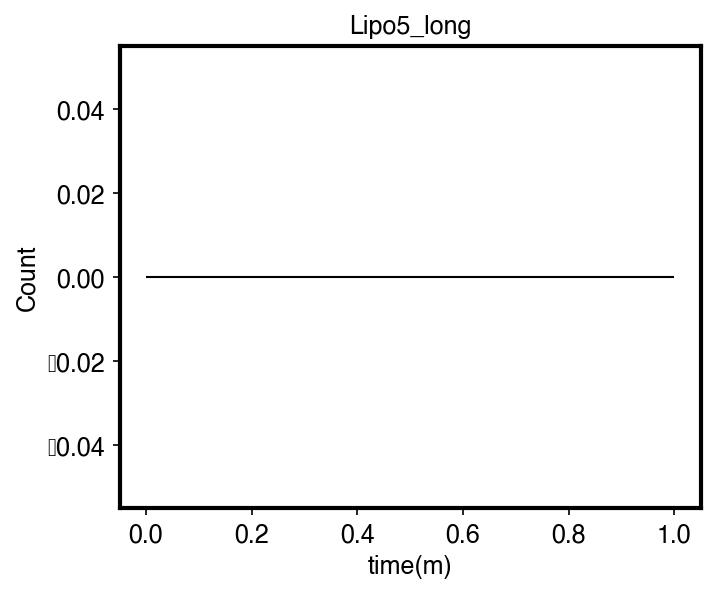

In [205]:
df_peaks = pd.read_excel(
    f"./{OUTPUT_PATH}peak_analysis.xlsx", converters={"concentration": str}
)
for condition_str in ["Lipo5_long"]:
    df_plot = df_peaks[df_peaks["application"] == condition_str]
    fig, ax = plt.subplots(figsize=(5, 4))
    sns.histplot(df_plot, x="time(m)", bins=25, ax=ax).get_figure()
    ax.set_title(condition_str)
    fig.savefig(f"{OUTPUT_PATH}/time_histogram_{condition_str}.jpg")

### Barplots

In [34]:
df_agg = pd.read_excel(OUTPUT_PATH / "cell_analysis.xlsx", converters={'concentration': str})
df_agg[["cell_type"]].drop_duplicates().values.flatten().tolist()

['CHO_WT', 'CHO_mA1']

Saving plot to: C:\python_projects\peak_analysis\peak_analysis\notebooks\output\covid_vaccine\CaMobilization\R-CEPIA1er\response_rate_peak_count.png
Saving plot to: C:\python_projects\peak_analysis\peak_analysis\notebooks\output\covid_vaccine\CaMobilization\R-CEPIA1er\mean_peak_count.png
Saving plot to: C:\python_projects\peak_analysis\peak_analysis\notebooks\output\covid_vaccine\CaMobilization\R-CEPIA1er\mean_mean_peak_amplitude.png
Saving plot to: C:\python_projects\peak_analysis\peak_analysis\notebooks\output\covid_vaccine\CaMobilization\R-CEPIA1er\mean_max_peak_amplitude.png


c:\python_projects\peak_analysis\peak_analysis\notebooks\../src/main/python\peak_analysis\helper_methods.py:313: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.savefig(
c:\python_projects\peak_analysis\peak_analysis\notebooks\../src/main/python\peak_analysis\helper_methods.py:313: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.savefig(
c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\events.py:89: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  func(*args, **kwargs)


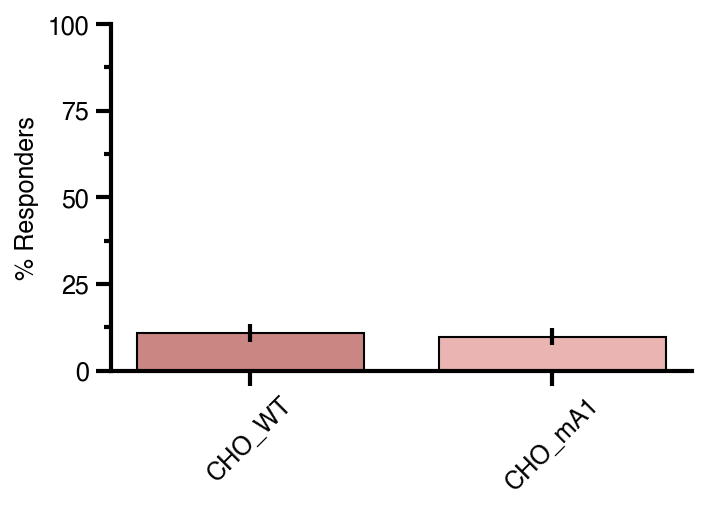

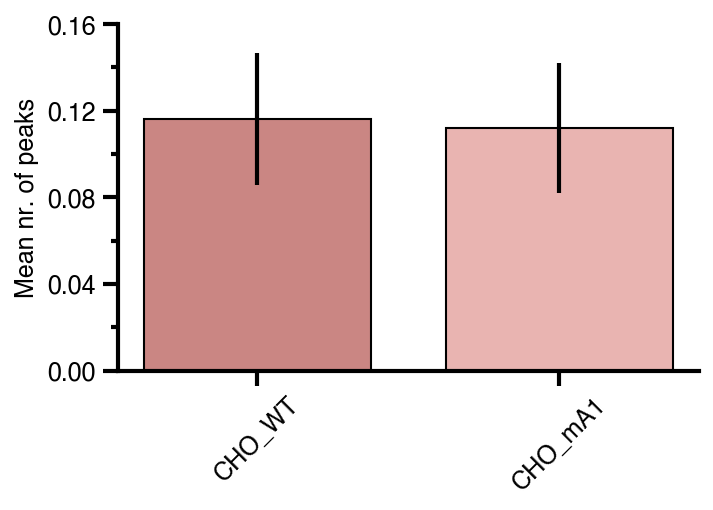

c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.canvas.print_figure(bytes_io, **kw)


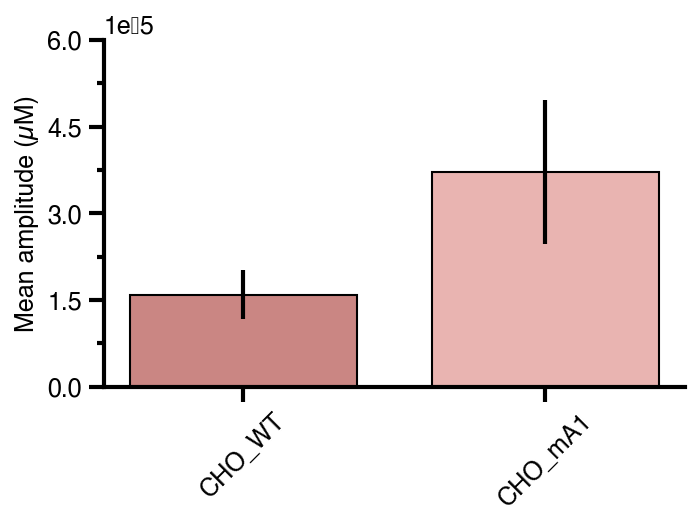

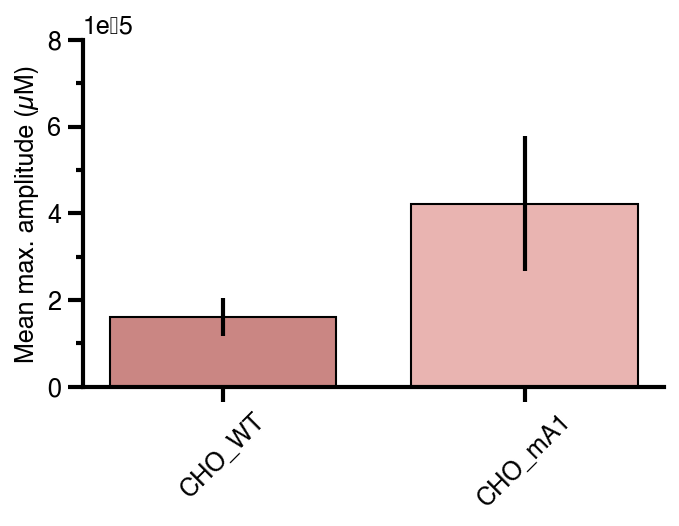

In [ ]:
df_agg = pd.read_excel(
    OUTPUT_PATH / "cell_analysis.xlsx", converters={"concentration": str, "pH": str}
)
for c in df_agg.columns:
    if "amplitude" in c:
        df_agg[c] = df_agg[c] / 1000.0

# df_agg = df_agg[
#     ~df_agg["application"].isin(["Mirus0.2"])
# ]

# add dummy zero
# df_dummy = df_agg.iloc[[-1], :].copy()
# df_dummy["application"] = ["lipo+HC"]
# df_dummy["cell_ID"] = ["DUMMY"]
# df_dummy["cell_nr_combined"] = [np.nan]
# df_dummy["peak_count"] = [0]
# df_dummy["first_peak_time"] = [np.nan]
# df_dummy["max_peak_time"] = [np.nan]
# df_dummy["mean_peak_amplitude"] = [0.0]
# df_dummy["max_peak_amplitude"] = [0.0]
# df_agg = pd.concat([df_agg, df_dummy], ignore_index=True)

# df_agg["application_concentration"] = (
#     df_agg[["application", "concentration"]]
#     .apply(lambda x: '-'.join(x.astype(str).values), axis=1)
# )

comparisons = {
    "peak_count": ["response_rate", "mean"],
    "mean_peak_amplitude": ["mean"],
    "max_peak_amplitude": ["mean"],
}
# NOTE: This will mutate the input dataframe
plot_agg_output_comparison(
    df_agg=df_agg,
    comparisons=comparisons,
    primary_group_column="cell_type",
    # secondary_group_column="dilution",
    benchmark_group='CHO_WT',
    primary_group_order=[
       "CHO_WT",
       "CHO_mA1"
    ],
    n_major_ticks=4,
    n_minor_to_major=2,
    figsize=(5, 3),
    colors=("#D67B77", "#F2ABA8"),
    alpha=1.0,
    x_rotation=45,
    width=0.75,
    group_alias_dict={
        "nothing": "no appl.",
        "Mirus6_wt": "Mirus6 WT",
    },
    colname_alias_dict={
        "mean_peak_amplitude": "amplitude (µM)",
        "max_peak_amplitude": "max. amplitude (µM)",
        "peak_count": "nr. of peaks",
    },
    errorbar_type="se",
    savepath=OUTPUT_PATH,
)

### Cross-tabulate

In [ ]:
df_agg = pd.read_excel(OUTPUT_PATH / "cell_analysis.xlsx", converters={'concentration':str})
# df_agg["application"].str.contains('|'.join(["PS", "AITC", "caps"]))
sorted(set([a.split("_")[0] for a in df_agg["application"].unique()]))

['lipo e11+A96+U73122',
 'lipo e11+HC+U73122',
 'lipo e11+RR+U73122',
 'lipo e11+U73122',
 'lipo e11+U73433']

In [ ]:
condition_list = [
    'lipo e11+A96+U73122',
    'lipo e11+HC+U73122',
    'lipo e11+RR+U73122',
    'lipo e11+U73122_0Ca',
    'lipo e11+U73433'
]
for condition_str in condition_list:
    df_agg = pd.read_excel(OUTPUT_PATH / "cell_analysis.xlsx", converters={'concentration':str})

    # filter for the main application
    test = df_agg[
        df_agg["application"].str.contains(condition_str.replace("+", "\+"))
        # & ~df_agg["application"].str.contains("HC")

    ].copy()
    # since we filtered for the main application, we can remove it from the application names
    # lipo_PS -> PS but lipo_main -> lipo
    test["application"] = test["application"].str.replace(f"{condition_str}_", "")
    test["application"] = test["application"].str.replace("main", f"{condition_str}",)
    # we need to create a higher level cell_ID that contains all the segments for a cell
    # -> same as before but without application
    id_cols_temp = [
        "date",
        "exp_no",
        "cell_type",
        "pH",
        "dilution",
        "concentration",
        "temp",
        "cell_nr",
    ]
    test["cell_ID"] = test[id_cols_temp].apply(
        lambda x: "-".join(x.astype(str).values), axis=1
    )
    test["responded_IC"] = (test["peak_count"] > 0).astype(int)
    test: pd.DataFrame = test.pivot(
        index="cell_ID", columns="application", values="responded_IC"
    )
    test.columns.name = None
    # ======================== Create first table =======================
    table0 = (
        test.groupby(["AITC", "caps", "PS"])[[condition_str]].agg(
            lambda x: x.sum() / x.count() * 100
        )
    )
    table0.columns = [f"% responded to {condition_str}"]
    print(table0)
    # ======================== Create second table =======================
    print("-----------------------------------------")
    table1 = (
        test.groupby(["AITC", "caps", "PS"])[[condition_str]].agg(
            lambda x: x.sum()
        )
    )
    table1[condition_str] = table1[condition_str] / table1[condition_str].sum() * 100
    table1.columns = [f"% of {condition_str} responders"]
    print(table1)

    writer = pd.ExcelWriter(OUTPUT_PATH / f"crosstab_{condition_str}.xlsx", engine = 'openpyxl')
    table0.to_excel(writer, sheet_name = 'pct_agonists')
    table1.to_excel(writer, sheet_name = 'pct_application')
    writer.close()

    # reorder the columns and save as output
    agonist_names = ["PS", "AITC", "caps"]
    test[[condition_str] + agonist_names].to_excel(
        OUTPUT_PATH / f"agonist_analysis_{condition_str}.xlsx", index=True
    )

# test = agg_output.copy()
# test["responded_IC"] = (test["peak_count"] > 0).astype(int)
# test: pd.DataFrame = test.pivot(
#     index="cell_ID", columns="segment_name", values="responded_IC"
# )
# test.columns.name = None
# test = (
#     test.groupby(["Mirus"])[["AITC", "Capsaicin", "PS"]].agg(
#         lambda x: x.sum()
#     )
# )
# test[""]
# test.columns = ["% resp. to Mirus"]
# print(test)

              % responded to lipo e11+A96+U73122
AITC caps PS                                    
0    0    0                            23.076923
          1                            15.384615
     1    0                             9.090909
          1                            22.222222
1    0    0                             0.000000
          1                            10.606061
     1    0                            75.000000
          1                             9.821429
-----------------------------------------
              % of lipo e11+A96+U73122 responders
AITC caps PS                                     
0    0    0                             14.285714
          1                             14.285714
     1    0                              2.380952
          1                             19.047619
1    0    0                              0.000000
          1                             16.666667
     1    0                              7.142857
          1       

# Test

In [23]:


# df_data = df_combined_data[
#     (df_combined_data["exp_no"] == 9)
#     & (df_combined_data["date"] == "20250429")
# ]
df_data = df_combined_data.copy()

# When the peaks are local minima and not maxima we need to flip the data
if UPSIDE_DOWN:
    df_data["value"] = - df_data["value"]
else:
    pass

# calculate pre-treatment standard deviation for all traces
_df_data_start = df_data[
    (df_data['time(m)'] >= 0.0) & (df_data['time(m)'] <= 0.5)
].drop('time(m)', axis=1)
stdev_base: pd.Series = _df_data_start.groupby("cell_ID")["value"].std()

# true peaks cannot appear before 3 minutes!
# earliest_peak_pos: int = df_data[df_data['time(m)'] < 0.25]["pos"].max()
earliest_peak_pos: int = 0
# TODO: try to get rid of wide format shenanigans
# pivot to wide format
df_data_wide = (
    df_data[['time(m)', 'cell_ID', 'value']]
    .pivot(index='time(m)', columns='cell_ID')['value']
    .reset_index()
)
df_data_wide.columns.name = None


c:\python_projects\peak_analysis\peak_analysis\notebooks\../src/main/python\peak_analysis\helper_methods.py:689: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2, figsize=(10, 3))
c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\events.py:89: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  func(*args, **kwargs)
c:\Users\tamas\.conda\envs\peak_analysis\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Helvetica.
  fig.canvas.print_figure(bytes_io, **kw)


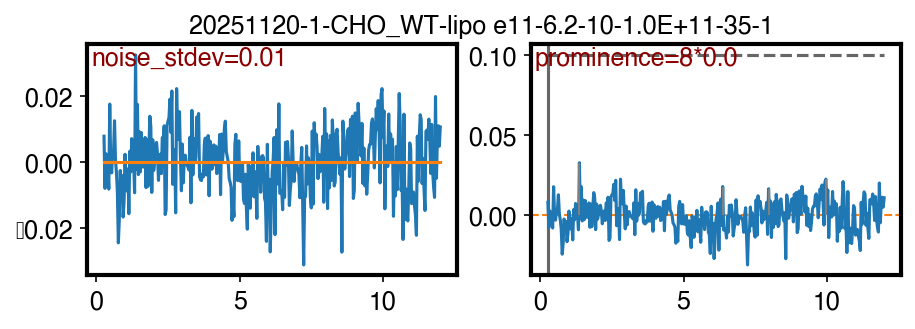

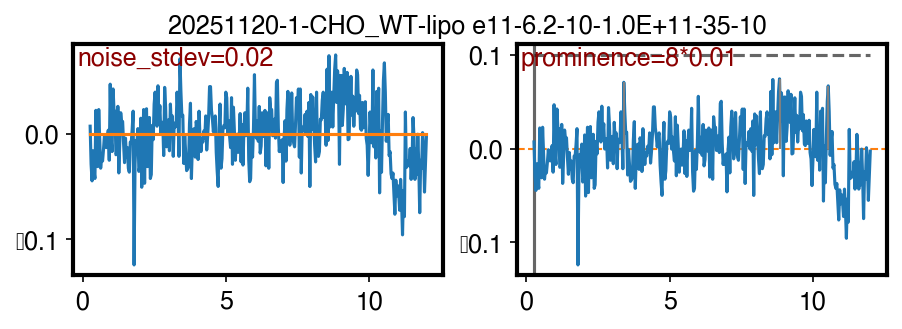

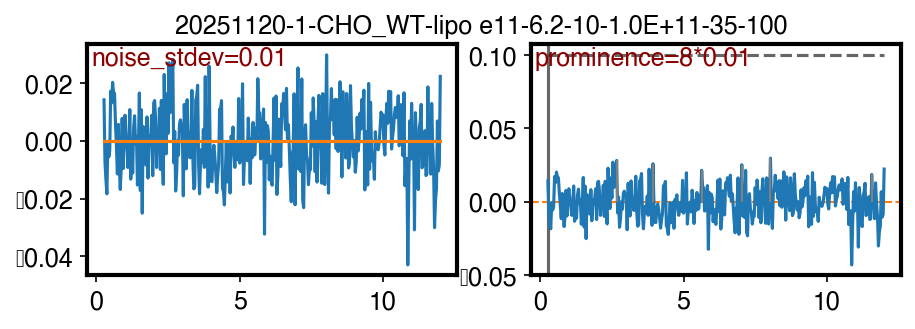

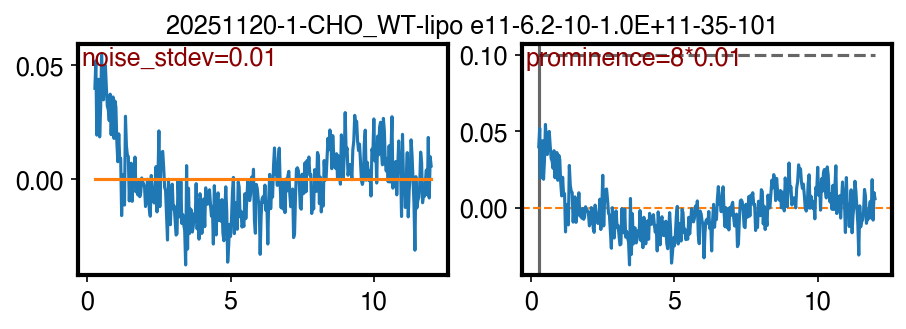

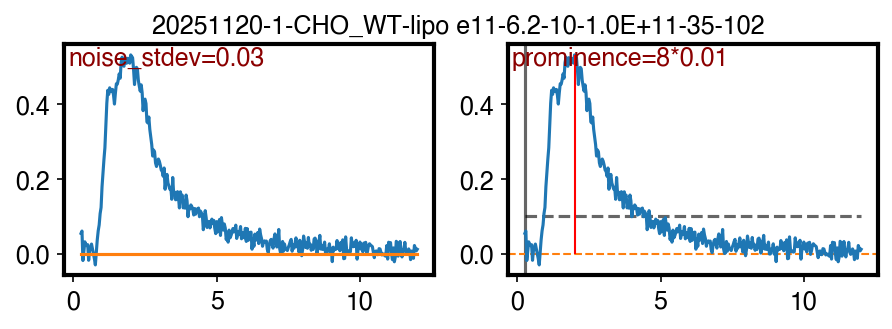

...

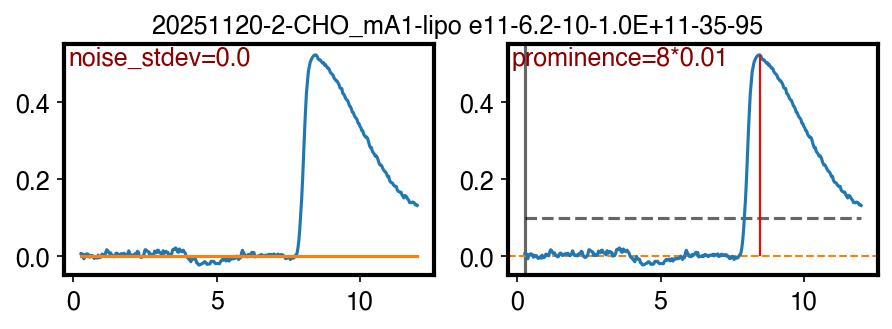

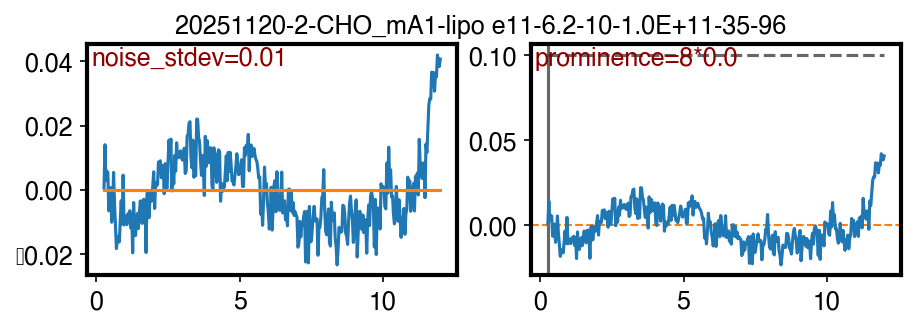

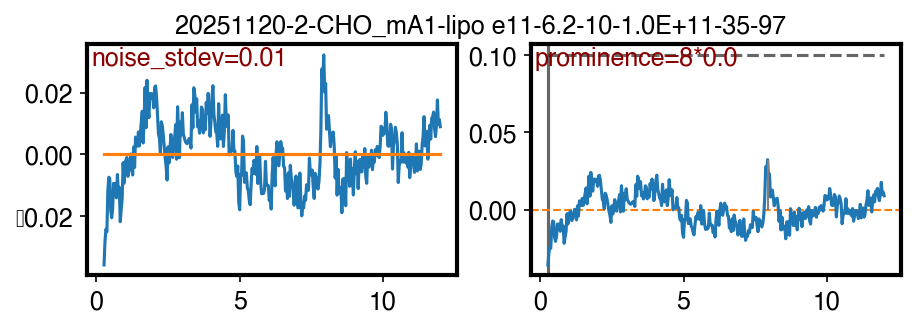

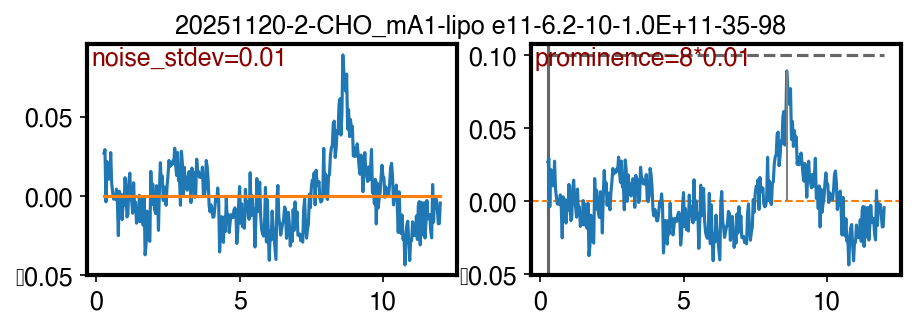

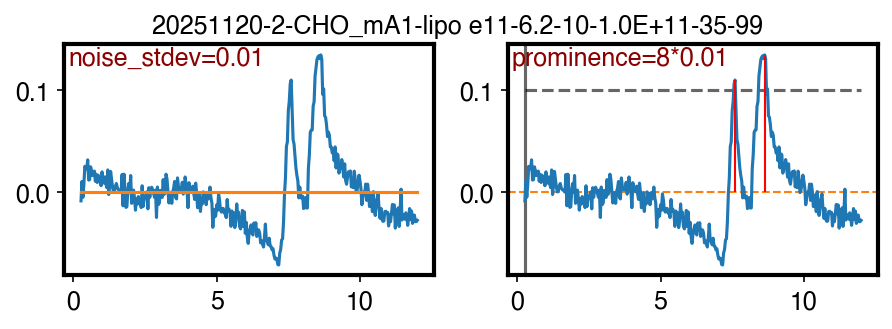

In [30]:
# baseline_fitter = FirstNBaseLineFitter(
#     agg_func=np.mean,
#     first_n=15
# )
# peak_detector = SingleMaxPeakDetector(
#     min_peak_amplitude=(50.0, 50.0),
#     earliest_peak_pos=0,
# )

# baseline_fitter = ModPolyCustomBaseLineFitter(
#     poly_order=2,
#     optional_segment_length=earliest_peak_pos
# )
baseline_fitter = None  # this is the same as passing ZeroBaselineFitter()
peak_detector = RobustNoiseSDScipyPeakDetector(
    prominence_in_stdev=8,
    wlen=100,
    distance=20,
    min_peak_amplitude=(0.1, 0.1),
    earliest_peak_pos=earliest_peak_pos,
    lower_quantile=0.05,
    upper_quantile=0.55,
    which_stdev ="estimated",
)

plot_processing(
    df_input=df_data_wide,
    time_colname='time(m)',
    baseline_fitter=baseline_fitter,
    peak_detector=peak_detector,
    s_stdev=stdev_base
)